## Importation des modules nécessaires à notre projet et ouverture de notre base de données

In [26]:
# We import all the libraries we need
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats

# Print of the current versions of our libraries
print('Pandas Version: ' + pd.__version__)
print('Python Version: ' + sys.version)
print('Matplotlib Version: ' + mpl.__version__)
print('Seaborn Version: ' + sns.__version__)
print('Numpy Version: ' + np.__version__)

# Reading of our database built in a CSV file
housing_data = pd.read_csv('/home/apprenant/Documents/Brief-6-Rachid-Karbiche/data/01_raw_data/housing_data.csv')

Pandas Version: 1.2.3
Python Version: 3.8.5 (default, Sep  4 2020, 07:30:14) 
[GCC 7.3.0]
Matplotlib Version: 3.3.4
Seaborn Version: 0.11.1
Numpy Version: 1.20.1


## Affichage des 10 premières lignes du jeu de données

In [27]:
# Displaying the ten first rows of the database
housing_data.head(10)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000
5,6,50,RL,85.0,14115,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,MnPrv,Shed,700,10,2009,WD,Normal,143000
6,7,20,RL,75.0,10084,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,8,2007,WD,Normal,307000
7,8,60,RL,NaN,10382,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,Shed,350,11,2009,WD,Normal,200000
8,9,50,RM,51.0,6120,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,4,2008,WD,Abnorml,129900
9,10,190,RL,50.0,7420,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,1,2008,WD,Normal,118000


## Affichage des informations sur les différentes variables de notre jeu de données

In [28]:
# Informations about the different variables of the database
housing_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

## Fonction qui permet de supprimer les colonnes qui présentent plus de 30 % de valeurs manquantes

In [29]:
# Function which removes the columns where the percentage of missing values is greater than 30 %
def delete_missing_values_columns(database, percentage_missing_values):
    """Function which returns a database without columns where the percentage of missing values is greater than 30 % """
    cols = database.columns[((database.isnull().sum() * 100) / len(database)) > percentage_missing_values]
    database = database.drop(cols, axis=1)
    return database

In [30]:
# Call of the function to remove the concerned columns
housing_data = delete_missing_values_columns(housing_data, 30)

In [31]:
print("Le jeu de données ne présente plus que {} colonnes".format(housing_data.shape[1]))

Le jeu de données ne présente plus que 76 colonnes


Nous n'avons plus que 76 colonnes. On peut continuer !

## Affichage des informations de la colonne SalePrice

In [32]:
# Rounding the informations about SalePrice attribute
round(housing_data.SalePrice.describe(), ndigits=2)

count      1460.0
mean     180921.2
std       79442.5
min       34900.0
25%      129975.0
50%      163000.0
75%      214000.0
max      755000.0
Name: SalePrice, dtype: float64

On utilise la fonction round() pour réduire la partie décimale 

## Affichage de la distribution de SalePrice

/home/apprenant/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='SalePrice', ylabel='Density'>

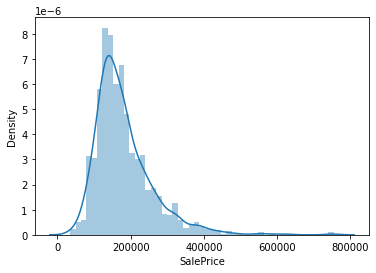

In [33]:
# Displaying a distribution plot of SalePrice
sns.distplot(housing_data['SalePrice'])

La distribution de SalePrice présente une asymétrie gauche donc un étalement à droite, ce qui signifie que les petites valeurs observées sont plus fréquentes que les valeurs plus élevées. On peut d'ailleurs le remarquer par le calcul également.

In [34]:
# Recording of the skewness of SalePrice
sale_price_skn = housing_data["SalePrice"].skew()

print("Le Skewness de SalePrice est de {:.2f}".format(sale_price_skn))       

Le Skewness de SalePrice est de 1.88


Le coefficient d'asymétrie est positif donc l'asymétrie est bien gauche.

# Focus sur les variables quantitatives

## Sélection des variables int64 et float64

Dans un premier temps, on récupère les listes des colonnes ayant les types demandés, d'une part en float, d'autre part en int.

In [35]:
# Recording of the attributes having the float type
float64_columns = housing_data.select_dtypes('float').columns
print("Liste des colonnes ayant pour type float : {}".format(float64_columns))
print('------------------------------')
# Recording of the attributes having the int type
int64_columns = housing_data.select_dtypes('int').columns
print("Liste des colonnes ayant pour type int : {}".format(int64_columns))

Liste des colonnes ayant pour type float : Index(['LotFrontage', 'MasVnrArea', 'GarageYrBlt'], dtype='object')
------------------------------
Liste des colonnes ayant pour type int : Index(['Id', 'MSSubClass', 'LotArea', 'OverallQual', 'OverallCond',
       'YearBuilt', 'YearRemodAdd', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF',
       'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea',
       'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr',
       'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageCars',
       'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch',
       'ScreenPorch', 'PoolArea', 'MiscVal', 'MoSold', 'YrSold', 'SalePrice'],
      dtype='object')


On affiche maintenant les histogrammes pour ces deux listes de colonnes.

array([[<AxesSubplot:title={'center':'LotFrontage'}>,
        <AxesSubplot:title={'center':'MasVnrArea'}>],
       [<AxesSubplot:title={'center':'GarageYrBlt'}>, <AxesSubplot:>]],
      dtype=object)

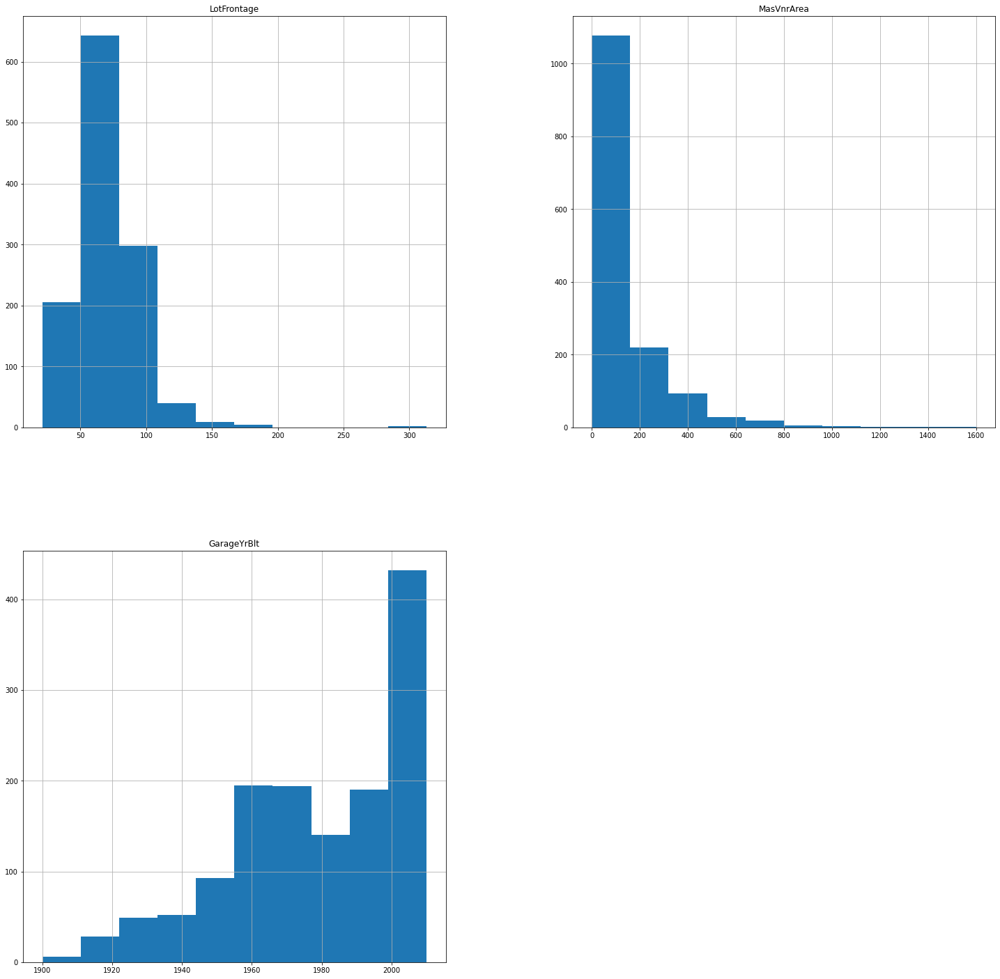

In [36]:
# Displaying the histograms of float-type columns
housing_data.hist(column=float64_columns, figsize=(25,25))

array([[<AxesSubplot:title={'center':'Id'}>,
        <AxesSubplot:title={'center':'MSSubClass'}>,
        <AxesSubplot:title={'center':'LotArea'}>,
        <AxesSubplot:title={'center':'OverallQual'}>,
        <AxesSubplot:title={'center':'OverallCond'}>,
        <AxesSubplot:title={'center':'YearBuilt'}>],
       [<AxesSubplot:title={'center':'YearRemodAdd'}>,
        <AxesSubplot:title={'center':'BsmtFinSF1'}>,
        <AxesSubplot:title={'center':'BsmtFinSF2'}>,
        <AxesSubplot:title={'center':'BsmtUnfSF'}>,
        <AxesSubplot:title={'center':'TotalBsmtSF'}>,
        <AxesSubplot:title={'center':'1stFlrSF'}>],
       [<AxesSubplot:title={'center':'2ndFlrSF'}>,
        <AxesSubplot:title={'center':'LowQualFinSF'}>,
        <AxesSubplot:title={'center':'GrLivArea'}>,
        <AxesSubplot:title={'center':'BsmtFullBath'}>,
        <AxesSubplot:title={'center':'BsmtHalfBath'}>,
        <AxesSubplot:title={'center':'FullBath'}>],
       [<AxesSubplot:title={'center':'HalfBath'}>,
 

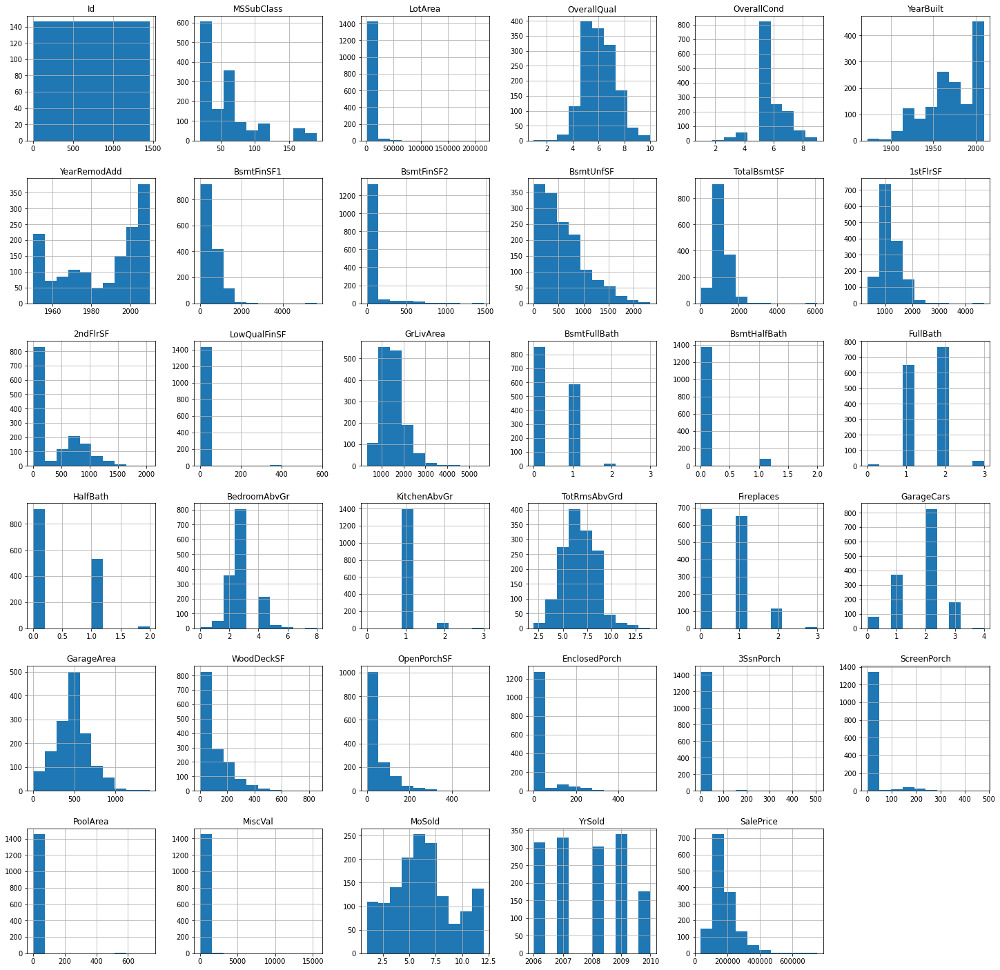

In [37]:
# Displaying the histograms of int-type columns
housing_data.hist(column=int64_columns, figsize=(25,25))

En comparant ces différents histogrammes avec celui de la colonne SalePrice, on remarque que certaines distributions sont assez proches de cette dernière. En attendant confirmation avec d'autres moyens, on peut citer les variables suivantes : LotFrontage, MasVnrArea, MSSubClass, BsmtFinSF1, TotalBsmtSF, 1stFlrSF, GrLivArea, TotRmsAbvGrd, GarageArea, WoodDeckSF, OpenPorchSF et MoSold. On peut en conclure que ces variables vont varier en fonction de SalePrice (elles suivraient donc plus ou moins la même progression que SalePrice).

## Avançons dans la corrélation !

Pour travailler sur ces valeurs de corrélation, nous allons chercher à ordonner toutes les valeurs que l'on obtient dans l'ordre décroissant. Voyons dans un premier temps les valeurs de type float :

In [38]:
# Creation of the dictionnary we'll use later
corr_dict = {}

# Loop to display and add in the dictionnary all the correlation coefficients for the float64-type columns
for i in float64_columns :
    corr_coeff = round(housing_data['SalePrice'].corr(housing_data[i]), ndigits=3)
    print("Le coefficient de corrélation entre SalePrice et {} est de {}".format(i, round(housing_data['SalePrice'].corr(housing_data[i]), ndigits=3)))
    corr_dict[i] = corr_coeff

Le coefficient de corrélation entre SalePrice et LotFrontage est de 0.352
Le coefficient de corrélation entre SalePrice et MasVnrArea est de 0.477
Le coefficient de corrélation entre SalePrice et GarageYrBlt est de 0.486


Voyons dans un second temps avec les valeurs de type int :

In [39]:
# Loop to display and add in the dictionnary all the correlation coefficients for the int64-type columns
for i in int64_columns :
    corr_coeff = round(housing_data['SalePrice'].corr(housing_data[i]), ndigits=3)
    print("Le coefficient de corrélation entre SalePrice et {} est de {}".format(i, round(housing_data['SalePrice'].corr(housing_data[i]), ndigits=3)))
    corr_dict[i] = corr_coeff

Le coefficient de corrélation entre SalePrice et Id est de -0.022
Le coefficient de corrélation entre SalePrice et MSSubClass est de -0.084
Le coefficient de corrélation entre SalePrice et LotArea est de 0.264
Le coefficient de corrélation entre SalePrice et OverallQual est de 0.791
Le coefficient de corrélation entre SalePrice et OverallCond est de -0.078
Le coefficient de corrélation entre SalePrice et YearBuilt est de 0.523
Le coefficient de corrélation entre SalePrice et YearRemodAdd est de 0.507
Le coefficient de corrélation entre SalePrice et BsmtFinSF1 est de 0.386
Le coefficient de corrélation entre SalePrice et BsmtFinSF2 est de -0.011
Le coefficient de corrélation entre SalePrice et BsmtUnfSF est de 0.214
Le coefficient de corrélation entre SalePrice et TotalBsmtSF est de 0.614
Le coefficient de corrélation entre SalePrice et 1stFlrSF est de 0.606
Le coefficient de corrélation entre SalePrice et 2ndFlrSF est de 0.319
Le coefficient de corrélation entre SalePrice et LowQualFin

Trions maintenant toutes nos valeurs dans l'ordre décroissant afin de déterminer les variables les plus corrélées avec SalePrice

In [40]:
# Sorting by descending all the correlation values
corr_dict_sorted_values = sorted(corr_dict, key=corr_dict.get, reverse=True)

# Printing of sentences which give the correlation coefficient of int-type and float-type attributes with SalePrice
for index, r in enumerate(corr_dict_sorted_values):
    print('{}. Coefficient de corrélation de {} : {}'.format(index + 1, r, corr_dict[r]))

1. Coefficient de corrélation de SalePrice : 1.0
2. Coefficient de corrélation de OverallQual : 0.791
3. Coefficient de corrélation de GrLivArea : 0.709
4. Coefficient de corrélation de GarageCars : 0.64
5. Coefficient de corrélation de GarageArea : 0.623
6. Coefficient de corrélation de TotalBsmtSF : 0.614
7. Coefficient de corrélation de 1stFlrSF : 0.606
8. Coefficient de corrélation de FullBath : 0.561
9. Coefficient de corrélation de TotRmsAbvGrd : 0.534
10. Coefficient de corrélation de YearBuilt : 0.523
11. Coefficient de corrélation de YearRemodAdd : 0.507
12. Coefficient de corrélation de GarageYrBlt : 0.486
13. Coefficient de corrélation de MasVnrArea : 0.477
14. Coefficient de corrélation de Fireplaces : 0.467
15. Coefficient de corrélation de BsmtFinSF1 : 0.386
16. Coefficient de corrélation de LotFrontage : 0.352
17. Coefficient de corrélation de WoodDeckSF : 0.324
18. Coefficient de corrélation de 2ndFlrSF : 0.319
19. Coefficient de corrélation de OpenPorchSF : 0.316
20. C

Les dix valeurs les plus corrélées avec SalePrice (à partir de la position 2) sont OverallQual, GrLivArea, GarageCars, GarageArea, TotalBsmtSF, 1stFlrSF, FullBath, TotRmsAbvGrd, YearBuilt et YearRemodAdd.

## Déterminons la relation entre SalePrice et les variables sélectionnés

Créons un pairplot pour afficher les relations entre les variables sélectionnées : 

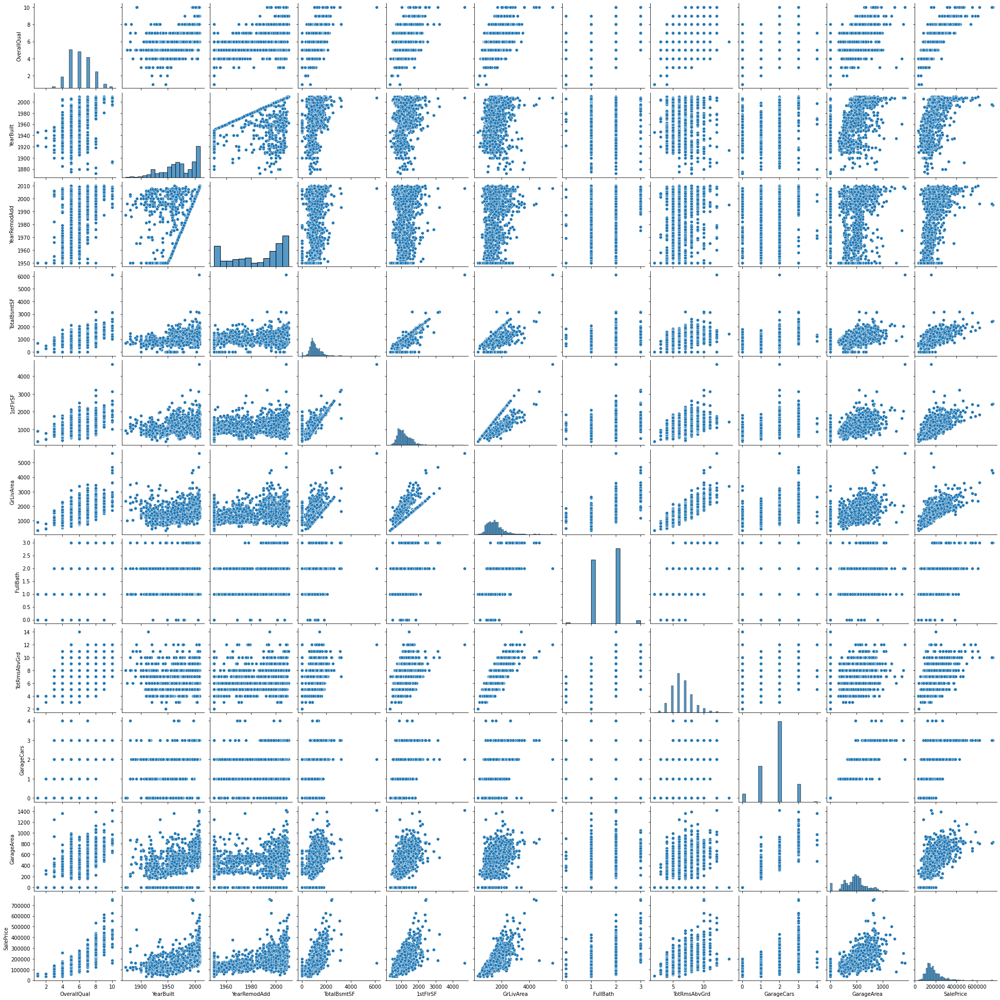

In [41]:
# Selection of columns to determine the relation between these columns and SalePrice
selected_columns = housing_data[['OverallQual', 'YearBuilt', 'YearRemodAdd', 'TotalBsmtSF', '1stFlrSF', 'GrLivArea', 'FullBath', 'TotRmsAbvGrd', 'GarageCars', 'GarageArea', 'SalePrice']]
sns.pairplot(selected_columns)

Réalisons un nouveau pairplot avec les trois variables les plus corrélées avec SalePrice

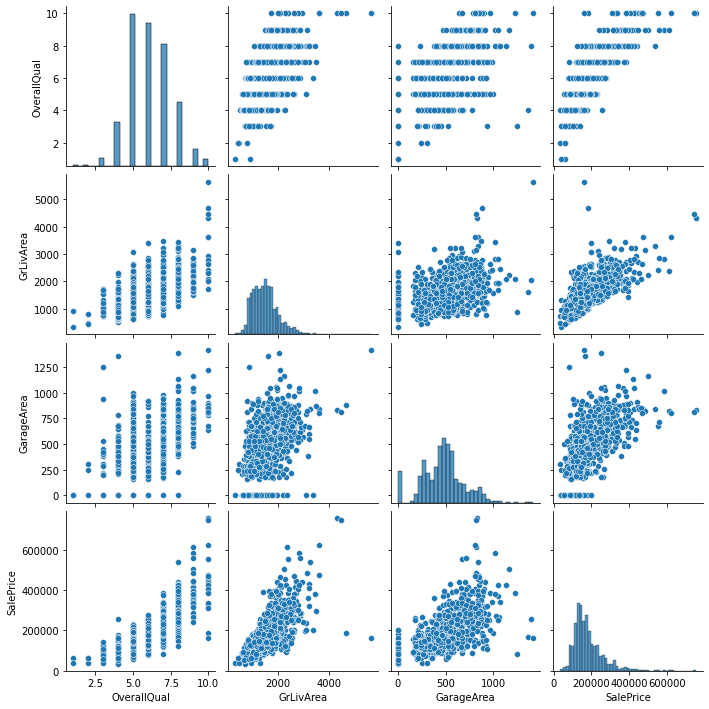

In [42]:
# Displaying pairplots to show the correlation between SalePrice and some variables 
plot_sale_price = sns.pairplot(selected_columns, x_vars=['OverallQual', 'GrLivArea', 'GarageArea', 'SalePrice'], y_vars=['OverallQual', 'GrLivArea','GarageArea','SalePrice'])

Lorsqu'on compare SalePrice avec nos trois autres variables corrélées, on remarque qu'au plus la variable est corrélée avec SalePrice, au plus elle se rapproche de la forme d'une droite. En somme, lorsqu'on fait la corrélation entre SalePrice et ces trois variables, on remarque qu'on pourrait en déduire une fonction affine qui s'écrirait sous la forme y = ax + b

## Heatmap pour visualiser les corrélations 2 à 2

Nous allons créer une heatmap afin de voir les pairs les plus corrélées

<AxesSubplot:>

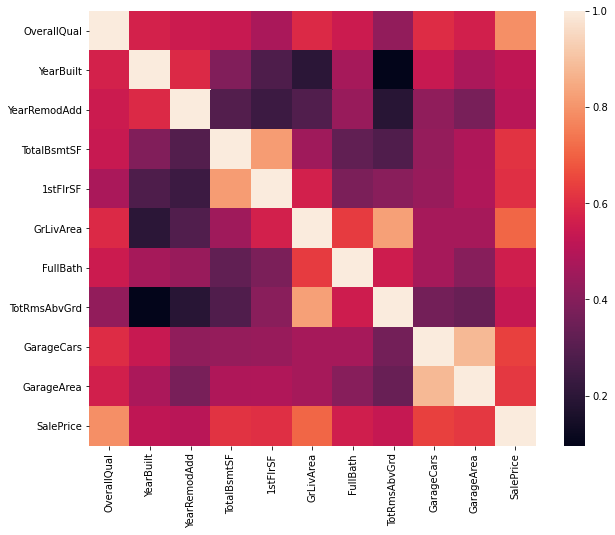

In [43]:
# Sizing of the heatmap
fig, ax = plt.subplots(figsize=(10, 8))

# Displaying the heatmap
selected_columns_corr = selected_columns.corr()
sns.heatmap(selected_columns_corr)

En observant la heatmap, on remarque que les cases les plus claires sont les pairs les plus corrélées. Les trois pairs les plus corrélées sont GarageArea/GarageCars, 1stFlrSF/TotalBsmtSF, TotRmsAbvGrd/GrLivArea (SalePrice/OverallQual aussi éventuellement).

## Modélisation d'une régression pour croiser des variables avec SalePrice

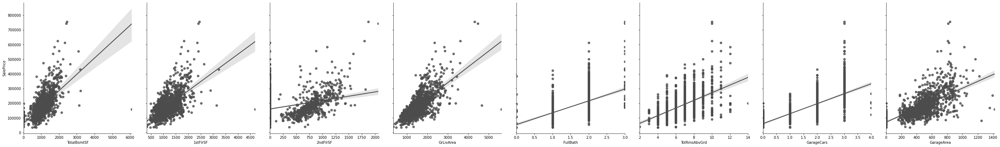

In [44]:
# Selection of some variables
selected_data = housing_data[['TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'GrLivArea', 'FullBath', 'TotRmsAbvGrd', 'GarageCars', 'GarageArea', 'SalePrice']]
variables = ['TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'GrLivArea', 'FullBath', 'TotRmsAbvGrd', 'GarageCars', 'GarageArea', 'SalePrice']

# Displaying of the regression plots with the selected variables
associated_variables = sns.PairGrid(selected_data, y_vars=['SalePrice'], x_vars=['TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'GrLivArea', 'FullBath', 'TotRmsAbvGrd', 'GarageCars', 'GarageArea'])
associated_variables.map(sns.regplot, color=".3")
associated_variables.fig.set_size_inches(40,7)

## Jointplot pour le croisement SalePrice et GrLivArea

Créons notre jointplot en affichant également le coefficient de Pearson

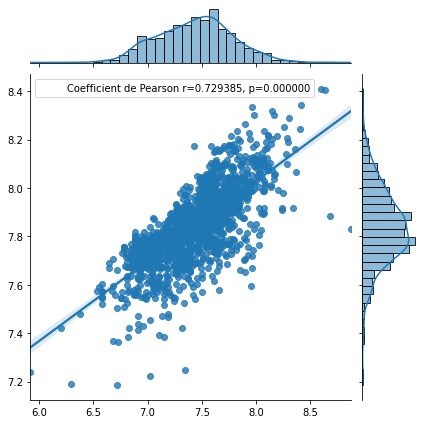

In [45]:
xt, _ = stats.boxcox(selected_data['GrLivArea'])
yt, _ = stats.boxcox(selected_data['SalePrice'])

# Displaying of a joint plot
joint_plot = sns.jointplot(data=selected_data, kind='reg', x = xt, y = yt)
    
r, p = stats.pearsonr(xt, yt)
phantom, = joint_plot.ax_joint.plot([], [], linestyle='', alpha=0)
joint_plot.ax_joint.legend([phantom], ['Coefficient de Pearson r={:f}, p={:f}'.format(r,p)])

Le coefficient de corrélation de Pearson est donc bien égal à environ 0.729.

# Focus sur les variables qualitatives

## Identification automatique des variables de type Object

In [46]:
# Function which automatically identifies all the variables of a certain type
def select_specified_type_variables(database, type):
    specified_type_list = database.select_dtypes(type).columns.tolist()
    return specified_type_list

# Recording of the function's return
objects_list = select_specified_type_variables(housing_data, 'object')
print(objects_list)

['MSZoning', 'Street', 'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual', 'Functional', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'SaleType', 'SaleCondition']


## Affichage de count plots des variables de type Object

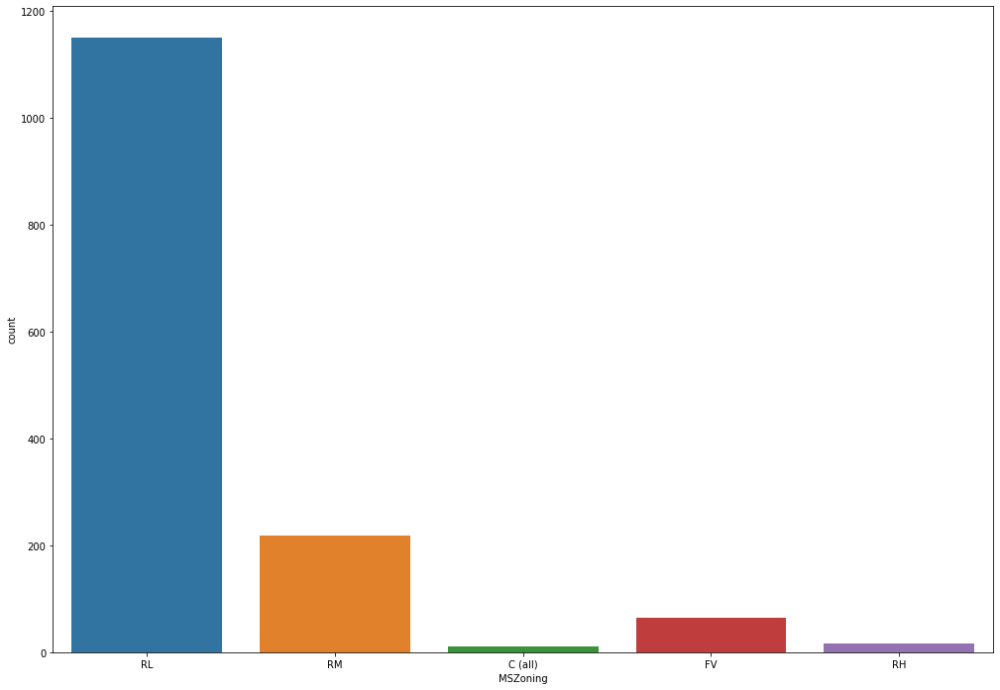

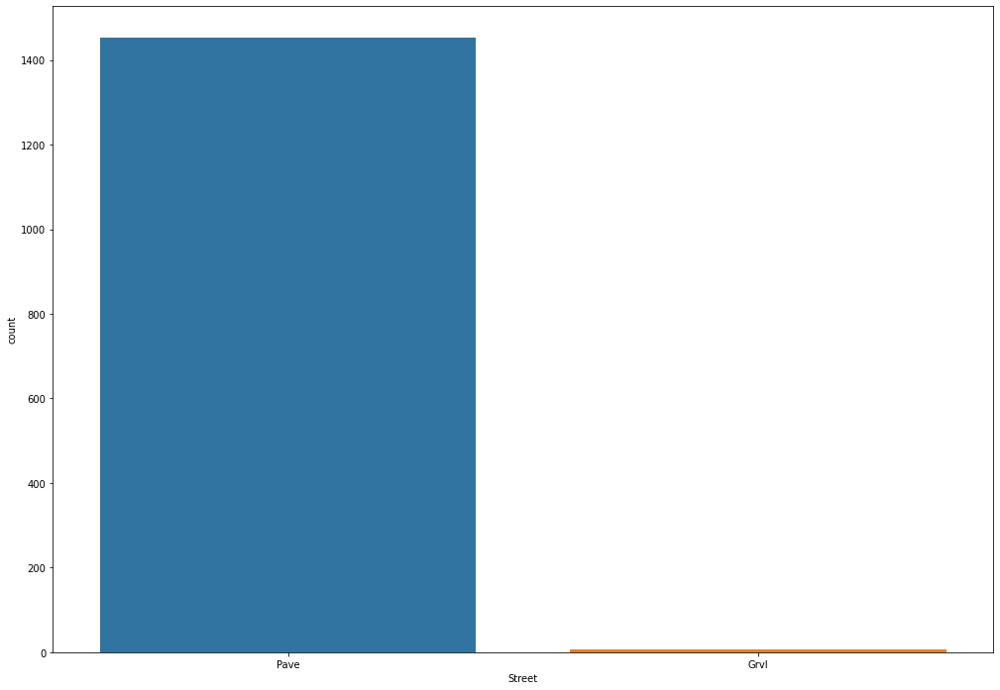

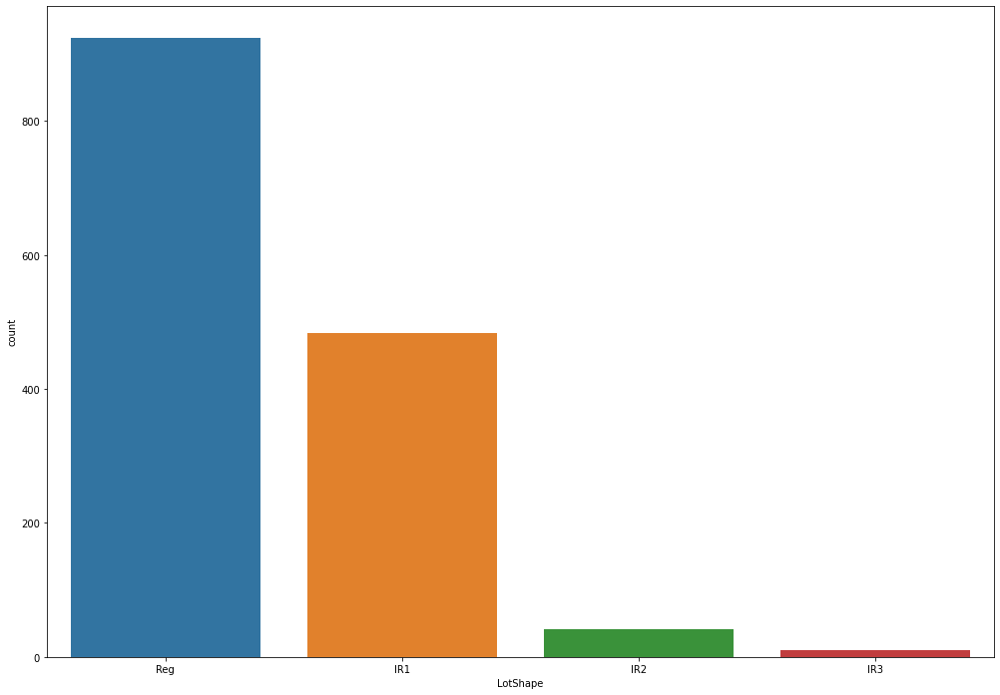

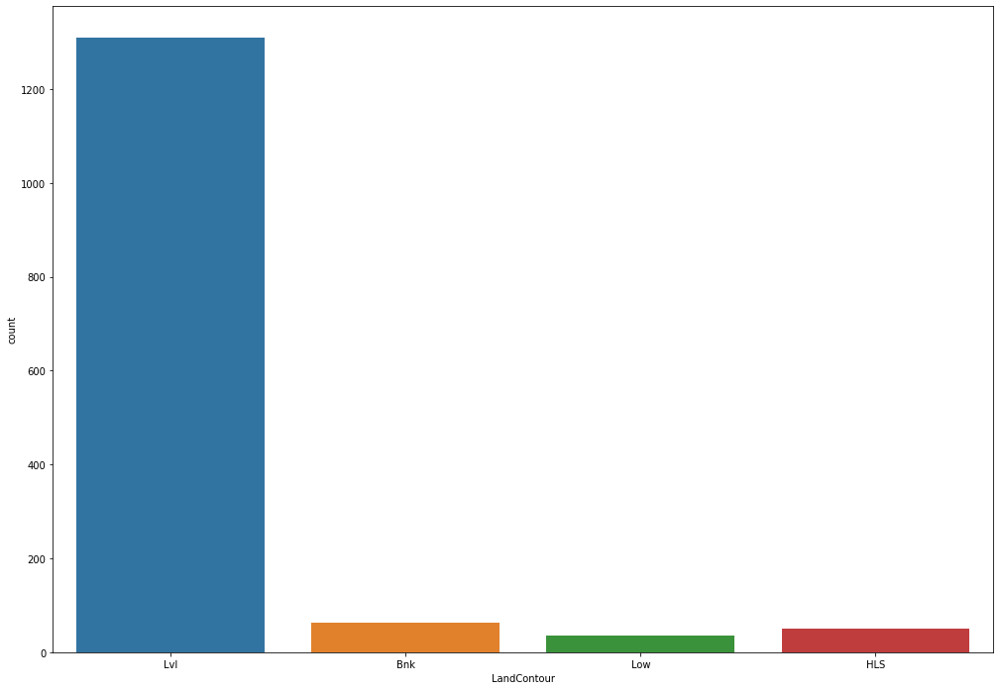

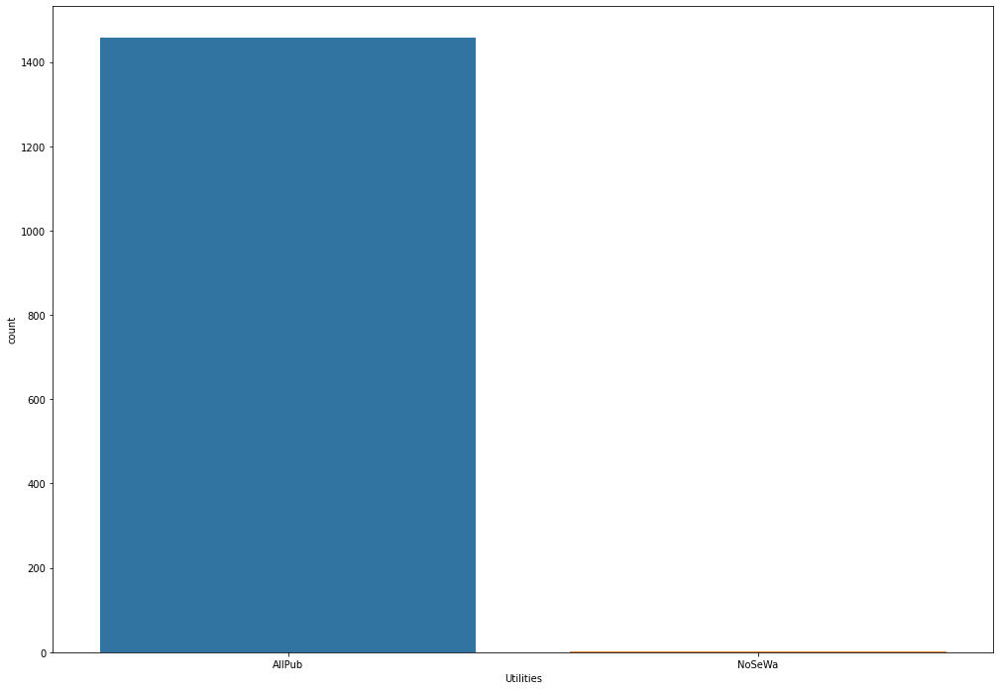

...

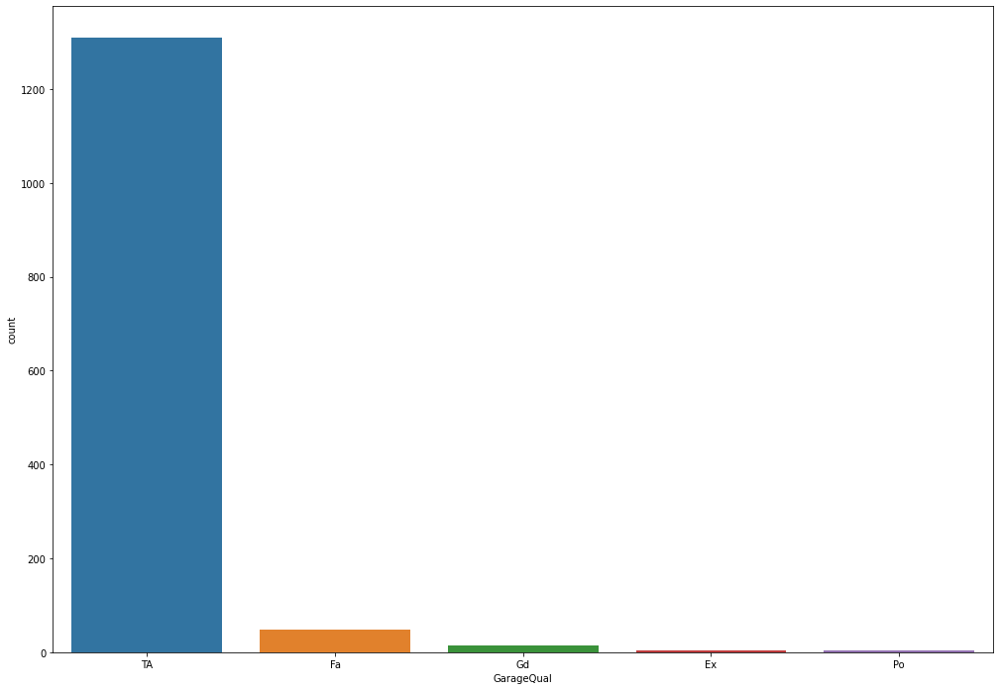

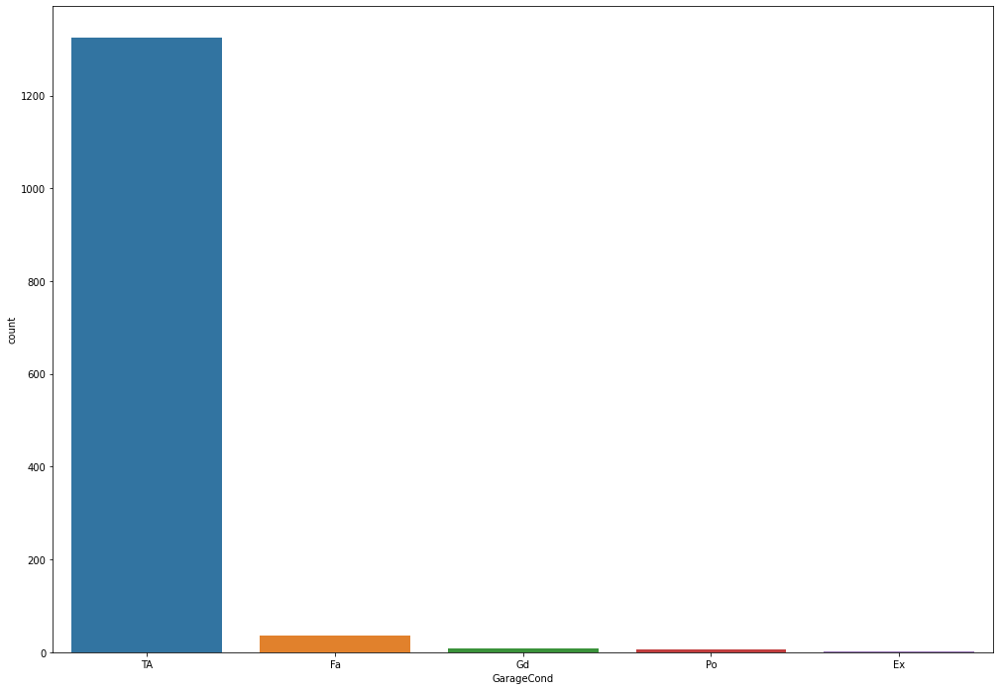

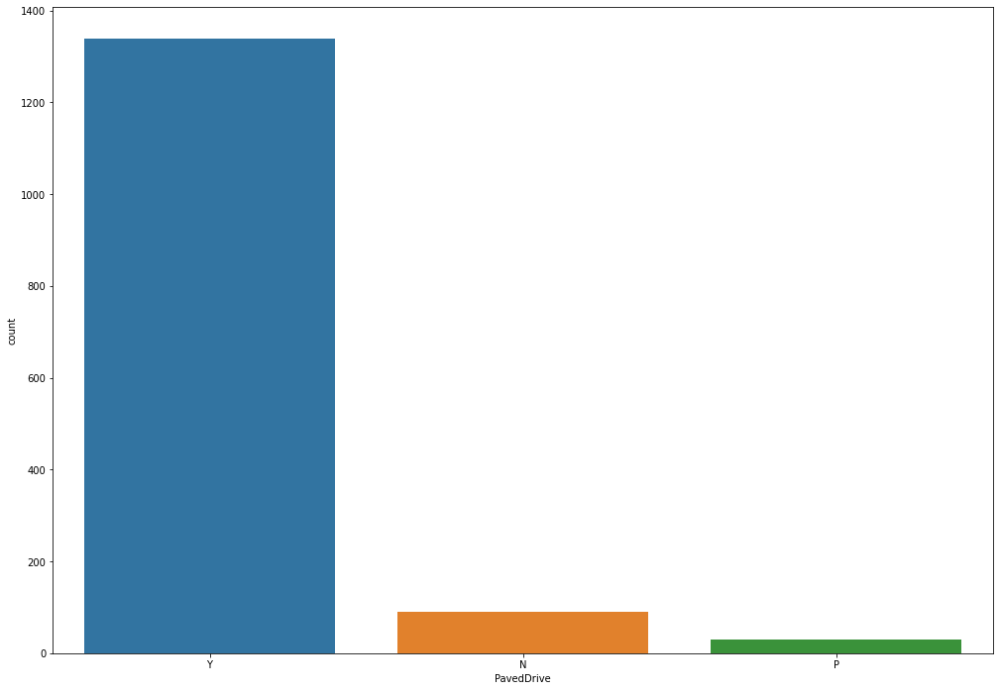

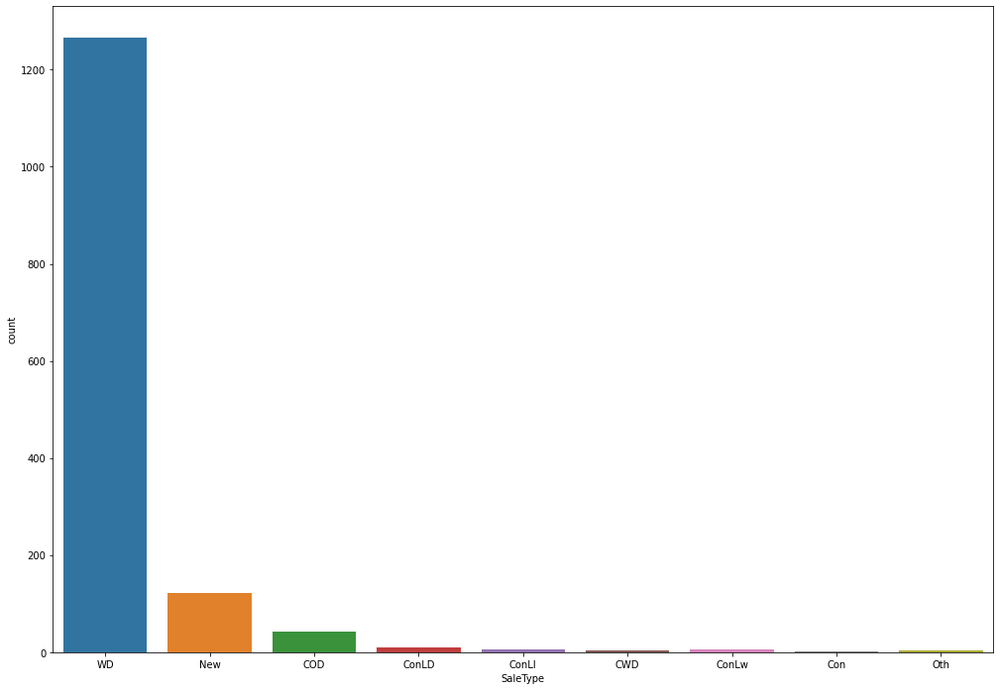

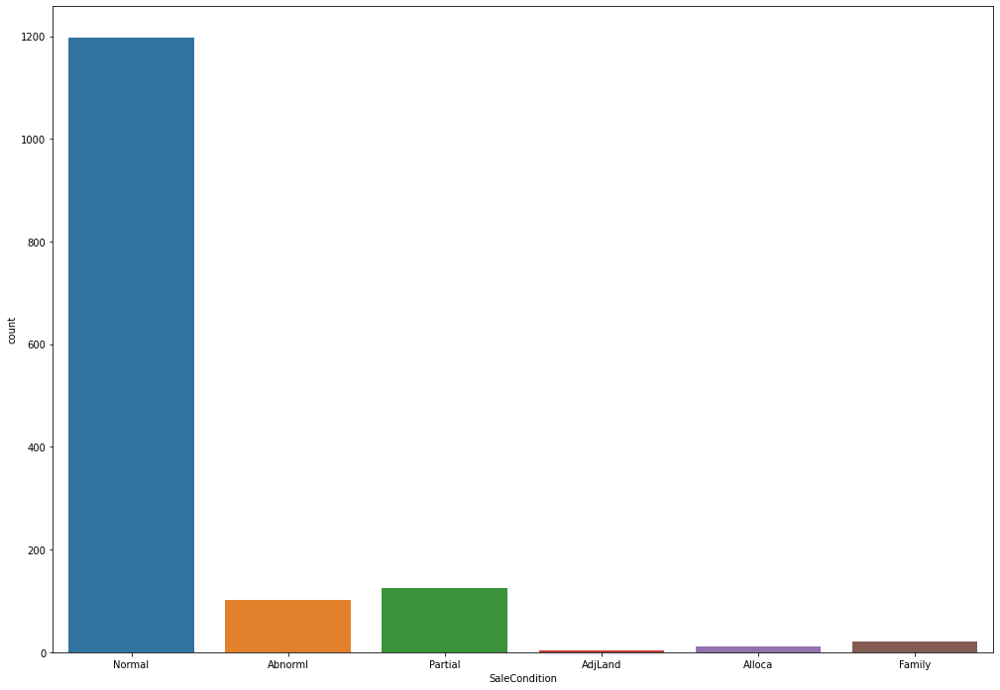

In [62]:
# Selecting the variables which will be useful to print the countplots
objects_data = housing_data[objects_list]

# Determining the size of the figure and the matrix
# fig, axs = plt.subplots(13,3, figsize=(20, 60))
# ax_iter = iter(axs.flat)

# Displaying all the figures at a time
for i, col in enumerate(objects_list):
    # ax = next(ax_iter)
    plt.figure(figsize=(17,12))
    sns.countplot(x=col, data=objects_data)
    plt.show()
    plt.close()

A l'oeil, on pourrait repérer de nombreuses variables inutiles. En effet, celles ayant des valeurs qui présentent un effectif proche de l'effectif total n'expliqueraient en rien le prix de la maison. Maintenant, voyons cela par le calcul.

## Liste des 5 variables qui ne semblent pas pertinentes pour expliquer le prix d'une maison

In [48]:
# Creation of a dictionnary we'll use later
parts_dict = {}

# Loop which iterates a sentence displaying the variable and its most important value
for i in objects_list:
    number_nlargest_value = objects_data[i].value_counts().nlargest(1)[0]
    part_nlargest_value = round((objects_data[i].value_counts().nlargest(1)[0]/objects_data.shape[0]) * 100, ndigits = 2)
    print('Variable {} : la valeur la plus fréquente compte {} unités, soit {} % des entrées totales.'.format(i, number_nlargest_value, part_nlargest_value))
    parts_dict[i] = part_nlargest_value
print('--------------------------------')
print(parts_dict)

Variable MSZoning : la valeur la plus fréquente compte 1151 unités, soit 78.84 % des entrées totales.
Variable Street : la valeur la plus fréquente compte 1454 unités, soit 99.59 % des entrées totales.
Variable LotShape : la valeur la plus fréquente compte 925 unités, soit 63.36 % des entrées totales.
Variable LandContour : la valeur la plus fréquente compte 1311 unités, soit 89.79 % des entrées totales.
Variable Utilities : la valeur la plus fréquente compte 1459 unités, soit 99.93 % des entrées totales.
Variable LotConfig : la valeur la plus fréquente compte 1052 unités, soit 72.05 % des entrées totales.
Variable LandSlope : la valeur la plus fréquente compte 1382 unités, soit 94.66 % des entrées totales.
Variable Neighborhood : la valeur la plus fréquente compte 225 unités, soit 15.41 % des entrées totales.
Variable Condition1 : la valeur la plus fréquente compte 1260 unités, soit 86.3 % des entrées totales.
Variable Condition2 : la valeur la plus fréquente compte 1445 unités, soit 

Maintenant, trions nos variables présentant une valeur ayant le monopole sur d'autres :

In [49]:
# Sorting of the dictionnary
parts_dict_sorted_values = sorted(parts_dict, key=parts_dict.get, reverse=True)

for index, p in enumerate(parts_dict_sorted_values):
    print('{}. Pourcentage de la valeur la plus fréquente de {} : {} %'.format(index + 1, p, parts_dict[p]))

1. Pourcentage de la valeur la plus fréquente de Utilities : 99.93 %
2. Pourcentage de la valeur la plus fréquente de Street : 99.59 %
3. Pourcentage de la valeur la plus fréquente de Condition2 : 98.97 %
4. Pourcentage de la valeur la plus fréquente de RoofMatl : 98.22 %
5. Pourcentage de la valeur la plus fréquente de Heating : 97.81 %
6. Pourcentage de la valeur la plus fréquente de LandSlope : 94.66 %
7. Pourcentage de la valeur la plus fréquente de CentralAir : 93.49 %
8. Pourcentage de la valeur la plus fréquente de Functional : 93.15 %
9. Pourcentage de la valeur la plus fréquente de PavedDrive : 91.78 %
10. Pourcentage de la valeur la plus fréquente de Electrical : 91.37 %
11. Pourcentage de la valeur la plus fréquente de GarageCond : 90.82 %
12. Pourcentage de la valeur la plus fréquente de LandContour : 89.79 %
13. Pourcentage de la valeur la plus fréquente de BsmtCond : 89.79 %
14. Pourcentage de la valeur la plus fréquente de GarageQual : 89.79 %
15. Pourcentage de la valeu

En triant dans l'ordre décroissant, les 5 variables qui ressortent sont : Utilities, Street, Condition2, RoofMatl et Heating. Elles ne semblent donc pas pertinentes pour expliquer le prix d'une maison.

In [63]:
cleaned_data = selected_columns.to_csv('/home/apprenant/Documents/Brief-6-Rachid-Karbiche/data/02_intermediate_data/cleaned_housing_data.csv')
cleaned_object_data = objects_data.to_csv('/home/apprenant/Documents/Brief-6-Rachid-Karbiche/data/02_intermediate_data/cleaned_object_housing_data.csv')
cleaned_all_data = housing_data.to_csv('/home/apprenant/Documents/Brief-6-Rachid-Karbiche/data/02_intermediate_data/cleaned_all_housing_data.csv')